<a href="https://colab.research.google.com/github/edouardrolland/Plume_Detection/blob/main/Machine_Vision_Input.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/obss/sahi/blob/main/demo/inference_for_yolov5.ipynb)

## 0. Preperation

- Install latest version of SAHI and ultralytics:

In [1]:
!pip install -U torch ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 901.3/901.3 kB 15.8 MB/s eta 0:00:00


In [2]:
!git clone https://github.com/dat-nguyenvn/sahifilter.git

Cloning into 'sahifilter'...
remote: Enumerating objects: 3501, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (14/14), done.
remote: Total 3501 (delta 15), reused 10 (delta 10), pack-reused 3477 (from 2)
Receiving objects: 100% (3501/3501), 68.59 MiB | 29.20 MiB/s, done.
Resolving deltas: 100% (2289/2289), done.


In [3]:
%cd /content

/content


In [4]:
%cd sahifilter
!pip install -e .

/content/sahifilter
Obtaining file:///content/sahifilter
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.2/62.2 MB 10.8 MB/s eta 0:00:00
  Building editable for sahi (pyproject.toml) ... done
  Created wheel for sahi: filename=sahi-0.11.19-0.editable-py3-none-any.whl size=8572 sha256=9556da08ade5c5098450ef2a7d7cd9fbc5ad138b68bc29d714f34461a28719b8
  Stored in directory: /tmp/pip-ephem-wheel-cache-8kjz347q/wheels/11/4a/d1/b3b93f08fcdf75cb4de9a4e2dc63a17796080134734cd03299
  Created wheel for fire: filename=fire-0.7.0-py3-none-any.whl size=114249 sha256=8cb087aa130077c5bba6d58a1ffeefc91fbb5b8dca50f1a4bc3d9101647b7905
  Stored in directory: /root/.cache/pip/wheels/19

In [5]:
import os
#os.getcwd()

- Import required modules:

In [6]:
# arrange an instance segmentation model for test
from sahi.utils.yolov8 import (
    download_yolov8s_model, download_yolov8s_seg_model
)

from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.utils.file import download_from_url
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image

- Download a yolov8 model and two test images:

In [ ]:
# download YOLOV5S6 model to 'models/yolov5s6.pt'
yolov8_model_path = "models/yolov8x.pt"
download_yolov8s_model(yolov8_model_path)

# download test images into demo_data folder
download_from_url('https://raw.githubusercontent.com/obss/sahi/main/demo/demo_data/small-vehicles1.jpeg', 'demo_data/small-vehicles1.jpeg')
download_from_url('https://raw.githubusercontent.com/obss/sahi/main/demo/demo_data/terrain2.png', 'demo_data/terrain2.png')

## 1. Standard Inference with a YOLOv8 Model

- Instantiate a detection model by defining model weight path and other parameters:

In [ ]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=yolov8_model_path,
    confidence_threshold=0.3,
    device="cuda", # or 'cuda:0'
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


- Perform prediction by feeding the get_prediction function with an image path and a DetectionModel instance:

In [ ]:
result = get_prediction("demo_data/small-vehicles1.jpeg", detection_model)

- Or perform prediction by feeding the get_prediction function with a numpy image and a DetectionModel instance:

In [ ]:
result = get_prediction(read_image("demo_data/small-vehicles1.jpeg"), detection_model)

- Visualize predicted bounding boxes and masks over the original image:

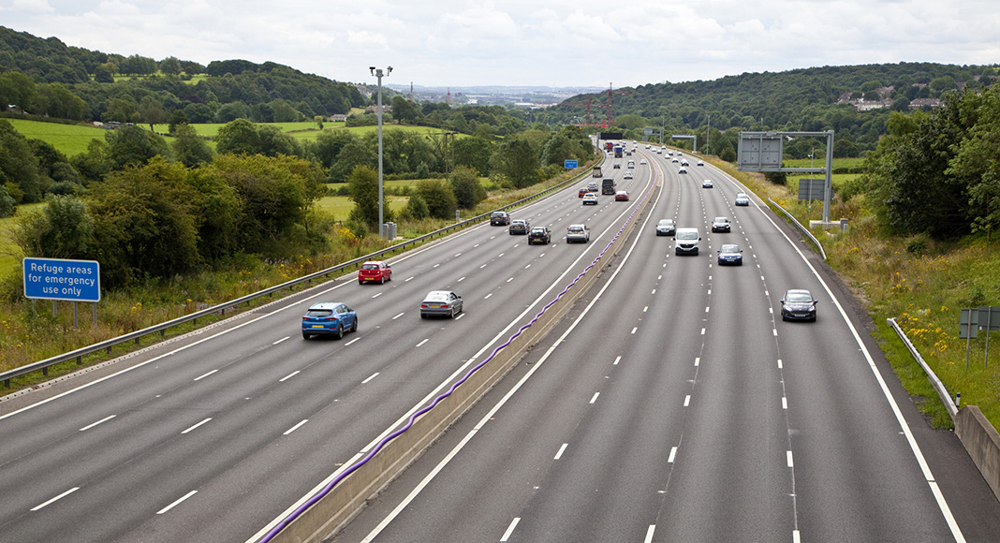

In [ ]:
result.export_visuals(export_dir="demo_data/")

Image("demo_data/prediction_visual.png")

## 2. Sliced Inference with a YOLOv8 Model

- To perform sliced prediction we need to specify slice parameters. In this example we will perform prediction over slices of 256x256 with an overlap ratio of 0.2:

In [ ]:
result = get_sliced_prediction(
    "demo_data/small-vehicles1.jpeg",
    detection_model,
    slice_height = 256,
    slice_width = 256,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)

Performing prediction on 15 slices.


- Visualize predicted bounding boxes and masks over the original image:

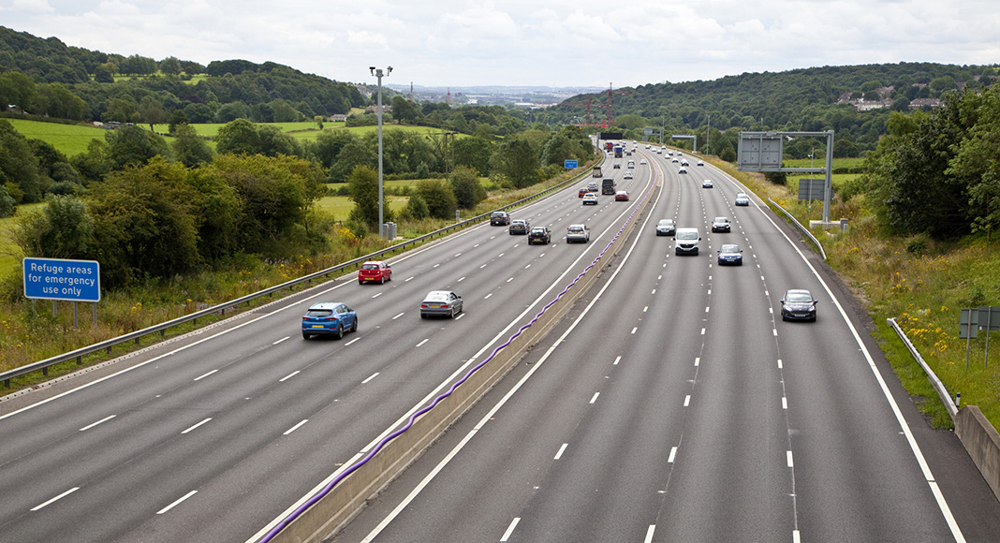

In [ ]:
result.export_visuals(export_dir="demo_data/")

Image("demo_data/prediction_visual.png")

## 3. Prediction Result

- Predictions are returned as [sahi.prediction.PredictionResult](sahi/prediction.py), you can access the object prediction list as:

In [ ]:
object_prediction_list = result.object_prediction_list

In [ ]:
object_prediction_list[0]

ObjectPrediction<
    bbox: BoundingBox: <(447.674072265625, 309.57244873046875, 495.7220458984375, 342.06915283203125), w: 48.0479736328125, h: 32.4967041015625>,
    mask: None,
    score: PredictionScore: <value: 0.8857606053352356>,
    category: Category: <id: 2, name: car>>

- ObjectPrediction's can be converted to [COCO annotation](https://cocodataset.org/#format-data) format:

In [ ]:
result.to_coco_annotations()[:3]

[{'image_id': None,
  'bbox': [447.674072265625,
   309.57244873046875,
   48.0479736328125,
   32.4967041015625],
  'score': 0.8857606053352356,
  'category_id': 2,
  'category_name': 'car',
  'segmentation': [],
  'iscrowd': 0,
  'area': 1561},
 {'image_id': None,
  'bbox': [321.2298278808594,
   322.0831069946289,
   61.74859619140625,
   41.10980987548828],
  'score': 0.872576892375946,
  'category_id': 2,
  'category_name': 'car',
  'segmentation': [],
  'iscrowd': 0,
  'area': 2538},
 {'image_id': None,
  'bbox': [832.658935546875,
   308.4786148071289,
   41.4306640625,
   36.40044403076172],
  'score': 0.8661476373672485,
  'category_id': 2,
  'category_name': 'car',
  'segmentation': [],
  'iscrowd': 0,
  'area': 1508}]

- ObjectPrediction's can be converted to [COCO prediction](https://github.com/i008/COCO-dataset-explorer) format:

In [ ]:
result.to_coco_predictions(image_id=1)[:3]

[{'image_id': 1,
  'bbox': [447.674072265625,
   309.57244873046875,
   48.0479736328125,
   32.4967041015625],
  'score': 0.8857606053352356,
  'category_id': 2,
  'category_name': 'car',
  'segmentation': [],
  'iscrowd': 0,
  'area': 1561},
 {'image_id': 1,
  'bbox': [321.2298278808594,
   322.0831069946289,
   61.74859619140625,
   41.10980987548828],
  'score': 0.872576892375946,
  'category_id': 2,
  'category_name': 'car',
  'segmentation': [],
  'iscrowd': 0,
  'area': 2538},
 {'image_id': 1,
  'bbox': [832.658935546875,
   308.4786148071289,
   41.4306640625,
   36.40044403076172],
  'score': 0.8661476373672485,
  'category_id': 2,
  'category_name': 'car',
  'segmentation': [],
  'iscrowd': 0,
  'area': 1508}]

- ObjectPrediction's can be converted to [imantics](https://github.com/jsbroks/imantics) annotation format:

In [ ]:
result.to_imantics_annotations()[:3]

- ObjectPrediction's can be converted to [fiftyone](https://github.com/voxel51/fiftyone) detection format:

In [ ]:
result.to_fiftyone_detections()[:3]

## 4. Batch Prediction

- Set model and directory parameters:

In [ ]:
model_type = "yolov8"
model_path = yolov8_model_path
model_device = "cpu" # or 'cuda:0'
model_confidence_threshold = 0.4

slice_height = 256
slice_width = 256
overlap_height_ratio = 0.2
overlap_width_ratio = 0.2

source_image_dir = "demo_data/"

- Perform sliced inference on given folder:

In [ ]:
predict(
    model_type=model_type,
    model_path=model_path,
    model_device=model_device,
    model_confidence_threshold=model_confidence_threshold,
    source=source_image_dir,
    slice_height=slice_height,
    slice_width=slice_width,
    overlap_height_ratio=overlap_height_ratio,
    overlap_width_ratio=overlap_width_ratio,
)

There are 3 listed files in folder: demo_data/


Performing inference on images:   0%|                                                | 0/3 [00:00<?, ?it/s]

Performing prediction on 15 slices.


Performing inference on images:  33%|█████████████▎                          | 1/3 [00:01<00:03,  1.88s/it]

Prediction time is: 1743.90 ms
Performing prediction on 15 slices.


Performing inference on images:  67%|██████████████████████████▋             | 2/3 [00:03<00:01,  1.80s/it]

Prediction time is: 1679.39 ms
Performing prediction on 20 slices.


Performing inference on images: 100%|████████████████████████████████████████| 3/3 [00:05<00:00,  1.99s/it]

Prediction time is: 2228.20 ms
Prediction results are successfully exported to runs/predict/exp8


# 0.6 Segmentation

Run above examples for segmentation model.

In [ ]:
#download YOLOV8S model to 'models/yolov8s.pt'
yolov8_seg_model_path = "models/yolov8x-seg.pt"
download_yolov8s_seg_model(yolov8_seg_model_path)

In [ ]:
detection_model_seg = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=yolov8_seg_model_path,
    confidence_threshold=0.3,
    device="cuda", # or 'cuda:0'
)

In [ ]:
!pwd

/content/sahifilter


In [ ]:
im = read_image("frame_0.jpg")
h = im.shape[0]
w = im.shape[1]

result = get_prediction("frame_0.jpg", detection_model_seg, full_shape=(h, w))

In [ ]:
!ls demo_data

prediction_visual.png  small-vehicles1.jpeg  terrain2.png


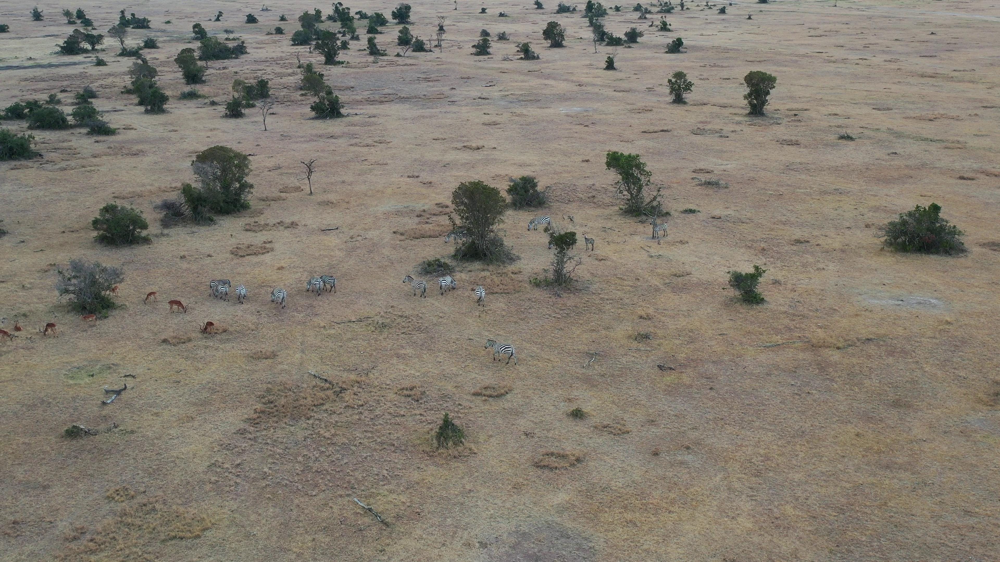

In [ ]:
result.export_visuals(export_dir="demo_data/")

Image("demo_data/prediction_visual.png")

In [ ]:
result = get_sliced_prediction(
    "demo_data/small-vehicles1.jpeg",
    detection_model_seg,
    slice_height = 256,
    slice_width = 256,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)

Performing prediction on 15 slices.


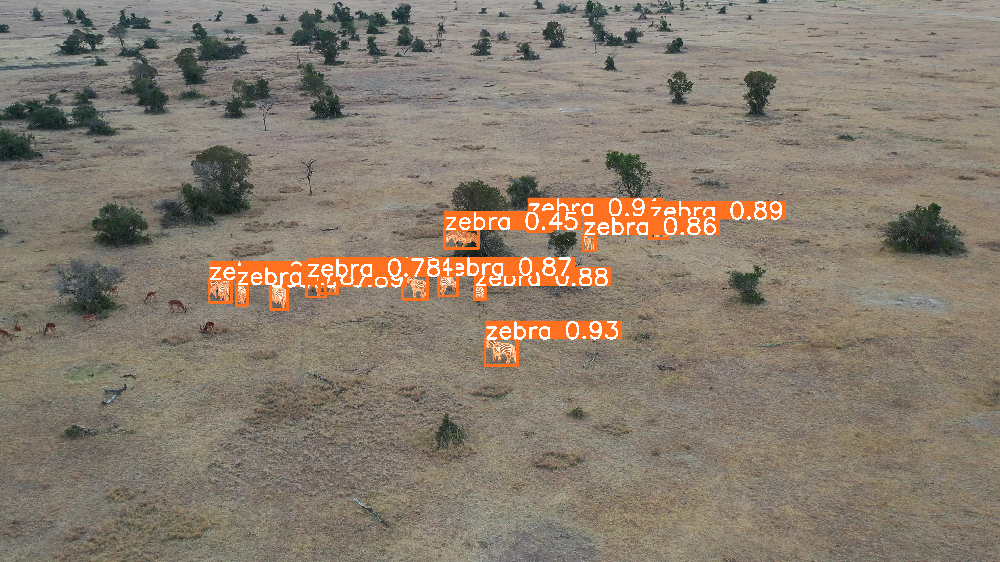

In [ ]:
result.export_visuals(export_dir="demo_data/")

Image("demo_data/prediction_visual.png")

In [ ]:
object_prediction_list = result.object_prediction_list
object_prediction_list[0]

ObjectPrediction<
    bbox: BoundingBox: <(1862, 1302, 1988, 1405), w: 126, h: 103>,
    mask: <sahi.annotation.Mask object at 0x7e3d94399930>,
    score: PredictionScore: <value: 0.9320725202560425>,
    category: Category: <id: 22, name: zebra>>

In [ ]:
object_prediction_list[0].mask.segmentation

[[1862,
  1302,
  1862,
  1341,
  1867,
  1341,
  1868,
  1340,
  1870,
  1340,
  1873,
  1337,
  1874,
  1337,
  1875,
  1336,
  1876,
  1336,
  1877,
  1335,
  1878,
  1335,
  1879,
  1334,
  1880,
  1334,
  1881,
  1333,
  1884,
  1333,
  1885,
  1334,
  1886,
  1334,
  1891,
  1339,
  1891,
  1341,
  1892,
  1342,
  1892,
  1343,
  1893,
  1344,
  1893,
  1345,
  1894,
  1346,
  1894,
  1349,
  1895,
  1350,
  1895,
  1361,
  1894,
  1362,
  1894,
  1380,
  1895,
  1381,
  1895,
  1383,
  1896,
  1384,
  1896,
  1385,
  1897,
  1386,
  1899,
  1386,
  1900,
  1385,
  1900,
  1384,
  1901,
  1383,
  1901,
  1380,
  1902,
  1379,
  1902,
  1373,
  1903,
  1372,
  1903,
  1371,
  1906,
  1368,
  1907,
  1368,
  1909,
  1366,
  1911,
  1368,
  1911,
  1369,
  1912,
  1370,
  1912,
  1372,
  1913,
  1373,
  1913,
  1386,
  1914,
  1387,
  1915,
  1387,
  1917,
  1389,
  1918,
  1389,
  1918,
  1388,
  1919,
  1387,
  1919,
  1386,
  1920,
  1385,
  1920,
  1382,
  1921,
  1381,
  1921,


Sliced predictions are much better

In [ ]:
predict(
    model_type=model_type,
    model_path=model_path,
    model_device=model_device,
    model_confidence_threshold=model_confidence_threshold,
    source=source_image_dir,
    slice_height=slice_height,
    slice_width=slice_width,
    overlap_height_ratio=overlap_height_ratio,
    overlap_width_ratio=overlap_width_ratio,
)

There are 3 listed files in folder: demo_data/


Performing inference on images:   0%|                                                | 0/3 [00:00<?, ?it/s]

Performing prediction on 15 slices.


Performing inference on images:  33%|█████████████▎                          | 1/3 [00:01<00:03,  1.74s/it]

Prediction time is: 1615.49 ms
Performing prediction on 15 slices.


Performing inference on images:  67%|██████████████████████████▋             | 2/3 [00:03<00:01,  1.70s/it]

Prediction time is: 1593.49 ms
Performing prediction on 20 slices.


Performing inference on images: 100%|████████████████████████████████████████| 3/3 [00:05<00:00,  1.86s/it]

Prediction time is: 2070.87 ms
Prediction results are successfully exported to runs/predict/exp9
